<a href="https://colab.research.google.com/github/neclipse/Metal_defects_detection/blob/Hao-training-practice/testing%20using%20R50_DC5_3x%20maxdets.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# install dependencies: 
!pip install pyyaml==5.1 pycocotools>=2.0.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

1.7.1+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [2]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.6)
# torch version updaed to 1.7.0; 11/24/2020
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html
     |████████████████████████████████| 6.6MB 4.7MB/s 
     |████████████████████████████████| 2.2MB 8.1MB/s 
     |████████████████████████████████| 51kB 5.8MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.3.post20210227-cp37-none-any.whl size=59001 sha256=2e498af3c814067dc8a900a520de85f29dfa6f30c5a9a6a67bac72a27cbfc632
  Stored in directory: /root/.cache/pip/wheels/89/4b/64/716bf9925b2bb322cf85281e7d34d36542847c544a85182d05
  Created wheel for iopath: filename=iopath-0.1.4-cp37-none-any.whl size=15571 sha256=068f2774f905bb9104dda01c02566bea9539a3c59789f8cc0af7eec2761b821f
  Stored in directory: /root/.cache/pip/wheels/54/3b/fb/25b60ef5989e3f5fd76fdc575c922e6e59066ddbd1b44756a9
Successfully built fvcore iopath
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling P

In [1]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



In [2]:
!wget https://raw.github.com/neclipse/Metal_defects_detection/Hao-training-practice/training_dataset2.zip
!unzip training_dataset2.zip > /dev/null

--2021-02-28 23:40:09--  https://raw.github.com/neclipse/Metal_defects_detection/Hao-training-practice/training_dataset2.zip
Resolving raw.github.com (raw.github.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.github.com (raw.github.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://raw.githubusercontent.com/neclipse/Metal_defects_detection/Hao-training-practice/training_dataset2.zip [following]
--2021-02-28 23:40:09--  https://raw.githubusercontent.com/neclipse/Metal_defects_detection/Hao-training-practice/training_dataset2.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 15007540 (14M) [application/zip]
Saving to: ‘training_dataset2.zip’

training_datas

In [3]:
!pip install labelme2coco

In [4]:
# import package
import labelme2coco
labelme2coco.convert("training_dataset2/train", "training_dataset2/train/annotation_train.json")
labelme2coco.convert("training_dataset2/validate", "training_dataset2/validate/annotation_validate.json")

In [5]:
from detectron2.data.datasets import register_coco_instances
# args: name(str), metadata (dict): default empty, json_file_path (str), image_root (str or path like): root directory for images  
register_coco_instances("my_dataset_t", {}, "training_dataset2/train/annotation_train.json", "")
register_coco_instances("my_dataset_v", {}, "training_dataset2/validate/annotation_validate.json", "")

[02/28 23:40:23 d2.data.datasets.coco]: Loaded 9 images in COCO format from training_dataset2/train/annotation_train.json
training_dataset2/train/800_012 cropped.png


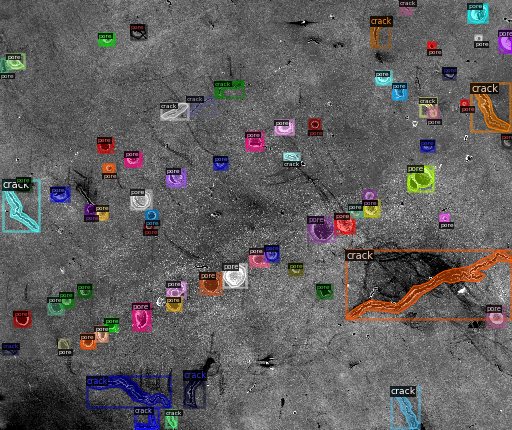

training_dataset2/train/800_013 cropped.png


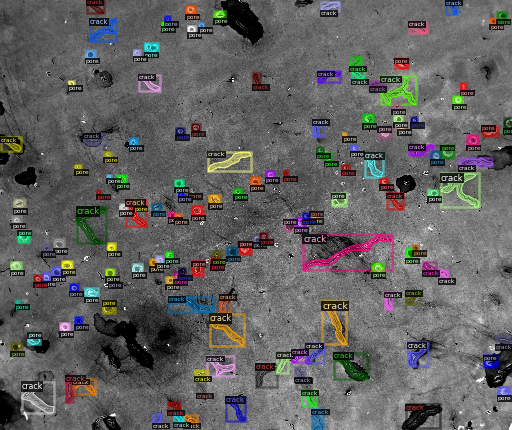

training_dataset2/train/1100_019 cropped.png


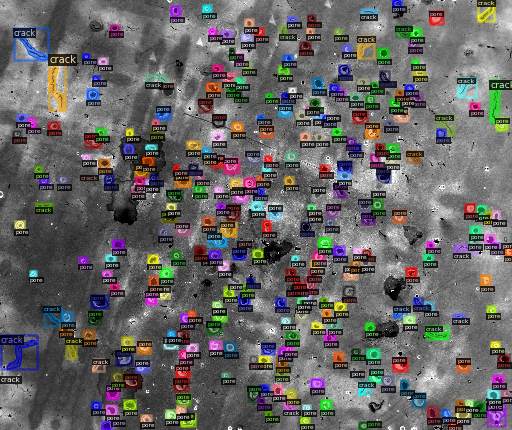

In [6]:
dataset_dict=DatasetCatalog.get("my_dataset_t")
mymetadata=MetadataCatalog.get("my_dataset_t")
#dataset_dicts = get_balloon_dicts("balloon/train")
for d in random.sample(dataset_dict, 3):
    print(d["file_name"])
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=mymetadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

In [7]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_DC5_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_t",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_DC5_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0025  # pick a good LR
cfg.SOLVER.MAX_ITER = 50   # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # two classes(crack and pore)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=True)
trainer.train()

[02/28 23:40:39 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
 

model_final_0464b7.pkl: 766MB [00:11, 67.7MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (3, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[02/28 23:40:55 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.7/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.7/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:217: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/

[02/28 23:41:14 d2.utils.events]:  eta: 0:00:28  iter: 19  total_loss: 3.096  loss_cls: 1.148  loss_box_reg: 0.6022  loss_mask: 0.6892  loss_rpn_cls: 0.3815  loss_rpn_loc: 0.2317  time: 0.9585  data_time: 0.0193  lr: 4.9952e-05  max_mem: 6877M
[02/28 23:41:34 d2.utils.events]:  eta: 0:00:09  iter: 39  total_loss: 2.385  loss_cls: 0.7739  loss_box_reg: 0.5992  loss_mask: 0.6564  loss_rpn_cls: 0.1317  loss_rpn_loc: 0.2031  time: 0.9699  data_time: 0.0066  lr: 9.9902e-05  max_mem: 6877M
[02/28 23:41:50 d2.utils.events]:  eta: 0:00:00  iter: 49  total_loss: 2.218  loss_cls: 0.6445  loss_box_reg: 0.6148  loss_mask: 0.6192  loss_rpn_cls: 0.117  loss_rpn_loc: 0.2175  time: 0.9731  data_time: 0.0069  lr: 0.00012488  max_mem: 6877M
[02/28 23:41:52 d2.engine.hooks]: Overall training speed: 48 iterations in 0:00:46 (0.9731 s / it)
[02/28 23:41:52 d2.engine.hooks]: Total training time: 0:00:55 (0:00:08 on hooks)


In [8]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [9]:
# cfg already contains everything we've set previously. Now we changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3   # set a custom testing threshold
cfg.TEST.DETECTIONS_PER_IMAGE = 1000
predictor = DefaultPredictor(cfg)

[02/28 23:42:01 d2.data.datasets.coco]: Loaded 2 images in COCO format from training_dataset2/validate/annotation_validate.json
training_dataset2/validate/1100_029 cropped.png


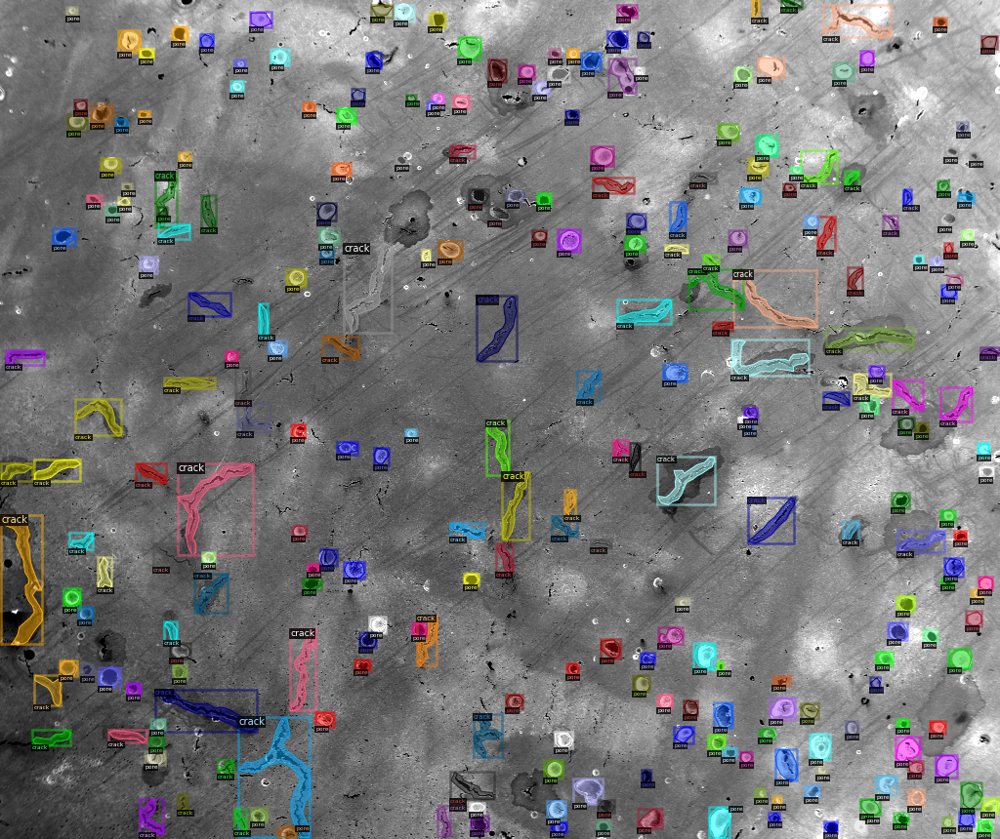

training_dataset2/validate/1100_028 cropped.png


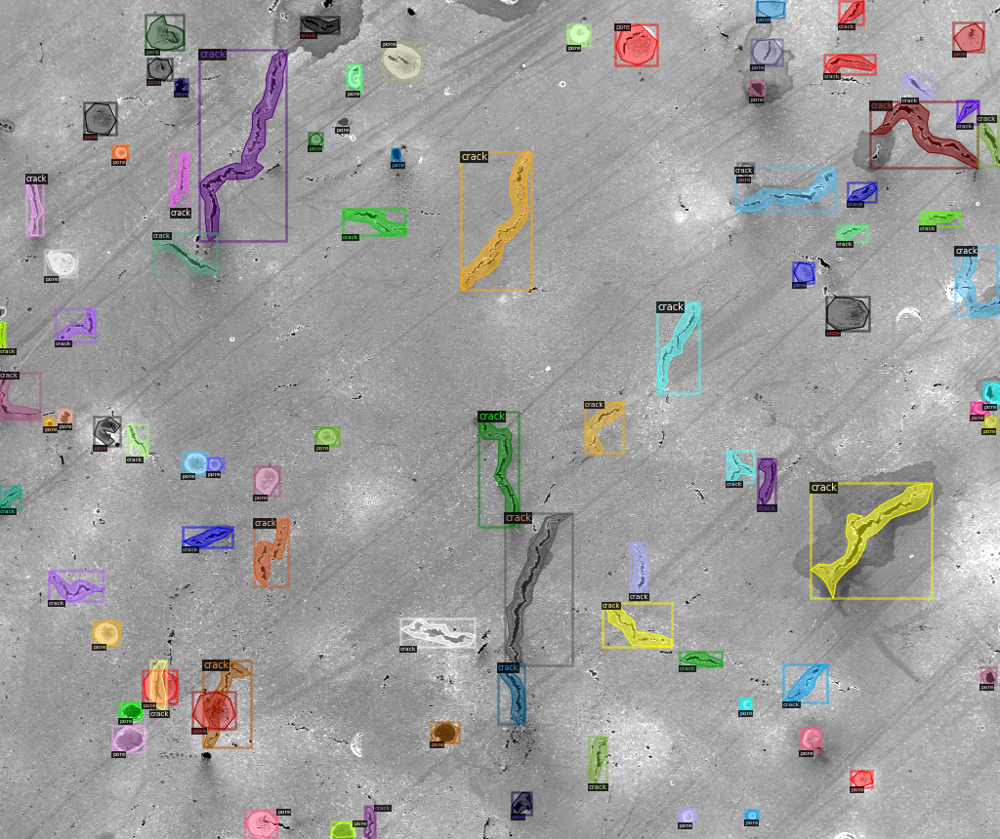

In [10]:
dataset_dict2=DatasetCatalog.get("my_dataset_v")
mymetadata2=MetadataCatalog.get("my_dataset_v")
#dataset_dicts = get_balloon_dicts("balloon/train")
for d in random.sample(dataset_dict2, 2):
    print(d["file_name"])
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=mymetadata2, scale=1)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

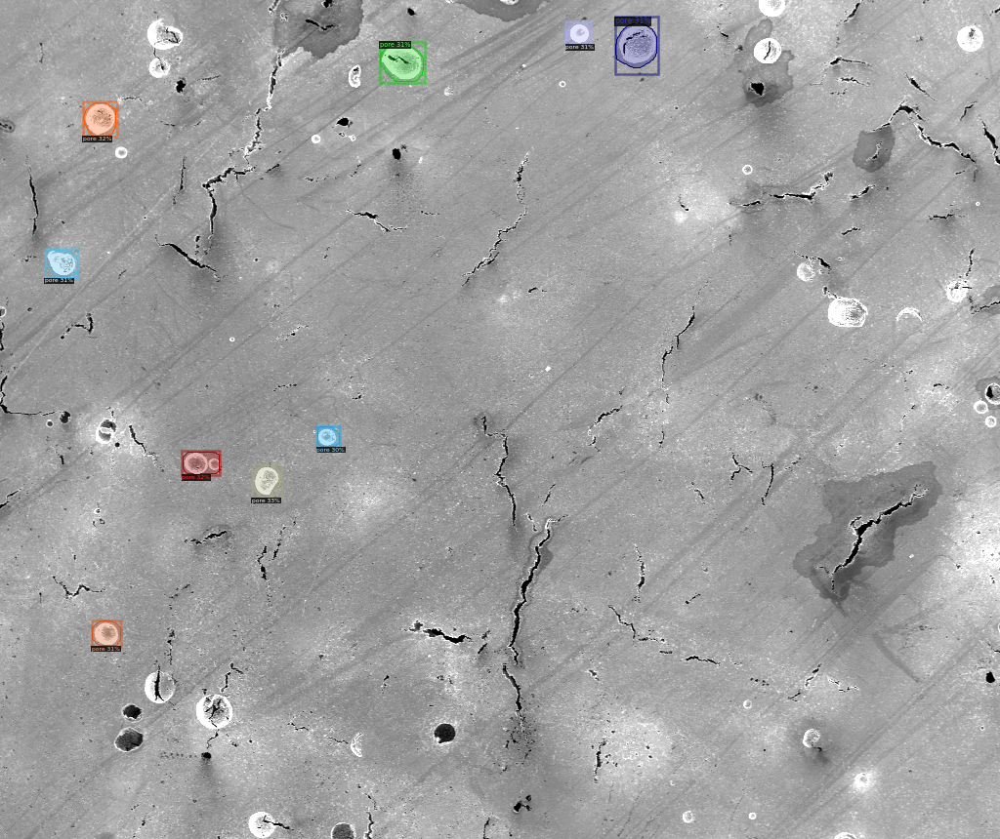

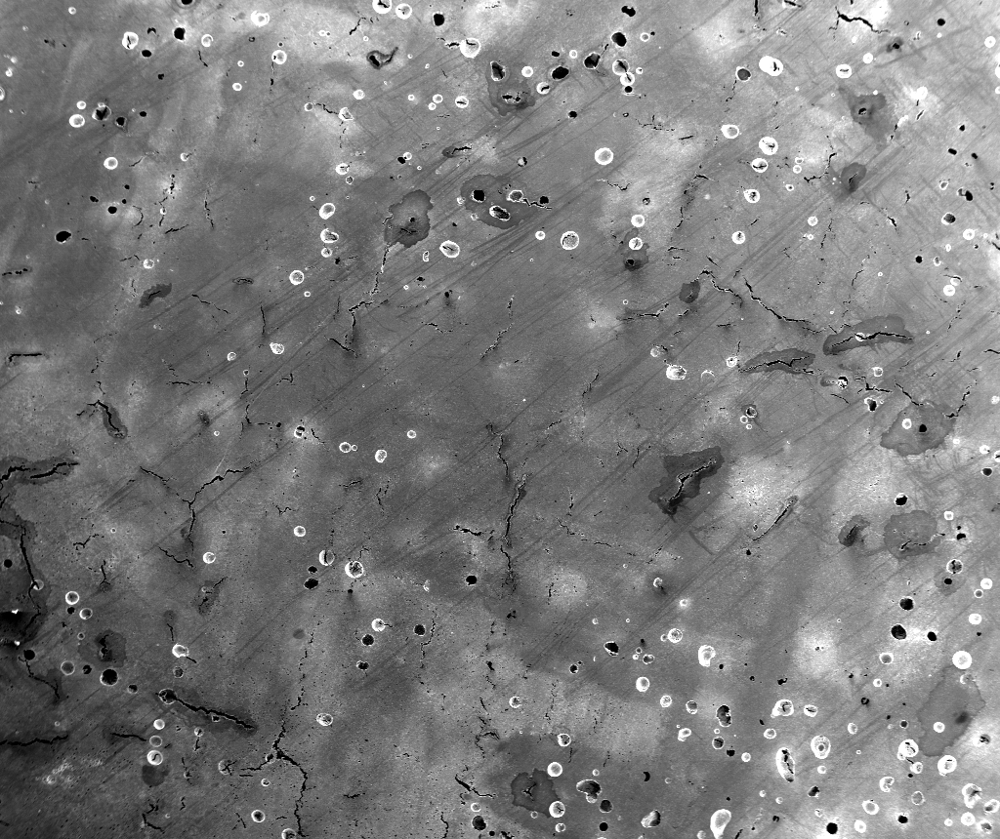

In [11]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = dataset_dict2
for d in random.sample(dataset_dicts, 2):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=mymetadata2, 
                   scale=1, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [19]:
import numpy as np
import datetime
import time
from pycocotools import mask as maskUtils
from collections import defaultdict
import copy

class COCOeval2:
    # Interface for evaluating detection on the Microsoft COCO dataset.
    #
    # The usage for CocoEval is as follows:
    #  cocoGt=..., cocoDt=...       # load dataset and results
    #  E = CocoEval(cocoGt,cocoDt); # initialize CocoEval object
    #  E.params.recThrs = ...;      # set parameters as desired
    #  E.evaluate();                # run per image evaluation
    #  E.accumulate();              # accumulate per image results
    #  E.summarize();               # display summary metrics of results
    # For example usage see evalDemo.m and http://mscoco.org/.
    #
    # The evaluation parameters are as follows (defaults in brackets):
    #  imgIds     - [all] N img ids to use for evaluation
    #  catIds     - [all] K cat ids to use for evaluation
    #  iouThrs    - [.5:.05:.95] T=10 IoU thresholds for evaluation
    #  recThrs    - [0:.01:1] R=101 recall thresholds for evaluation
    #  areaRng    - [...] A=4 object area ranges for evaluation
    #  maxDets    - [1 10 100] M=3 thresholds on max detections per image
    #  iouType    - ['segm'] set iouType to 'segm', 'bbox' or 'keypoints'
    #  iouType replaced the now DEPRECATED useSegm parameter.
    #  useCats    - [1] if true use category labels for evaluation
    # Note: if useCats=0 category labels are ignored as in proposal scoring.
    # Note: multiple areaRngs [Ax2] and maxDets [Mx1] can be specified.
    #
    # evaluate(): evaluates detections on every image and every category and
    # concats the results into the "evalImgs" with fields:
    #  dtIds      - [1xD] id for each of the D detections (dt)
    #  gtIds      - [1xG] id for each of the G ground truths (gt)
    #  dtMatches  - [TxD] matching gt id at each IoU or 0
    #  gtMatches  - [TxG] matching dt id at each IoU or 0
    #  dtScores   - [1xD] confidence of each dt
    #  gtIgnore   - [1xG] ignore flag for each gt
    #  dtIgnore   - [TxD] ignore flag for each dt at each IoU
    #
    # accumulate(): accumulates the per-image, per-category evaluation
    # results in "evalImgs" into the dictionary "eval" with fields:
    #  params     - parameters used for evaluation
    #  date       - date evaluation was performed
    #  counts     - [T,R,K,A,M] parameter dimensions (see above)
    #  precision  - [TxRxKxAxM] precision for every evaluation setting
    #  recall     - [TxKxAxM] max recall for every evaluation setting
    # Note: precision and recall==-1 for settings with no gt objects.
    #
    # See also coco, mask, pycocoDemo, pycocoEvalDemo
    #
    # Microsoft COCO Toolbox.      version 2.0
    # Data, paper, and tutorials available at:  http://mscoco.org/
    # Code written by Piotr Dollar and Tsung-Yi Lin, 2015.
    # Licensed under the Simplified BSD License [see coco/license.txt]
    def __init__(self, cocoGt=None, cocoDt=None, iouType='segm'):
        '''
        Initialize CocoEval using coco APIs for gt and dt
        :param cocoGt: coco object with ground truth annotations
        :param cocoDt: coco object with detection results
        :return: None
        '''
        if not iouType:
            print('iouType not specified. use default iouType segm')
        self.cocoGt   = cocoGt              # ground truth COCO API
        self.cocoDt   = cocoDt              # detections COCO API
        self.evalImgs = defaultdict(list)   # per-image per-category evaluation results [KxAxI] elements
        self.eval     = {}                  # accumulated evaluation results
        self._gts = defaultdict(list)       # gt for evaluation
        self._dts = defaultdict(list)       # dt for evaluation
        self.params = Params(iouType=iouType) # parameters
        self._paramsEval = {}               # parameters for evaluation
        self.stats = []                     # result summarization
        self.ious = {}                      # ious between all gts and dts
        if not cocoGt is None:
            self.params.imgIds = sorted(cocoGt.getImgIds())
            self.params.catIds = sorted(cocoGt.getCatIds())


    def _prepare(self):
        '''
        Prepare ._gts and ._dts for evaluation based on params
        :return: None
        '''
        def _toMask(anns, coco):
            # modify ann['segmentation'] by reference
            for ann in anns:
                rle = coco.annToRLE(ann)
                ann['segmentation'] = rle
        p = self.params
        if p.useCats:
            gts=self.cocoGt.loadAnns(self.cocoGt.getAnnIds(imgIds=p.imgIds, catIds=p.catIds))
            dts=self.cocoDt.loadAnns(self.cocoDt.getAnnIds(imgIds=p.imgIds, catIds=p.catIds))
        else:
            gts=self.cocoGt.loadAnns(self.cocoGt.getAnnIds(imgIds=p.imgIds))
            dts=self.cocoDt.loadAnns(self.cocoDt.getAnnIds(imgIds=p.imgIds))

        # convert ground truth to mask if iouType == 'segm'
        if p.iouType == 'segm':
            _toMask(gts, self.cocoGt)
            _toMask(dts, self.cocoDt)
        # set ignore flag
        for gt in gts:
            gt['ignore'] = gt['ignore'] if 'ignore' in gt else 0
            gt['ignore'] = 'iscrowd' in gt and gt['iscrowd']
            if p.iouType == 'keypoints':
                gt['ignore'] = (gt['num_keypoints'] == 0) or gt['ignore']
        self._gts = defaultdict(list)       # gt for evaluation
        self._dts = defaultdict(list)       # dt for evaluation
        for gt in gts:
            self._gts[gt['image_id'], gt['category_id']].append(gt)
        for dt in dts:
            self._dts[dt['image_id'], dt['category_id']].append(dt)
        self.evalImgs = defaultdict(list)   # per-image per-category evaluation results
        self.eval     = {}                  # accumulated evaluation results

    def evaluate(self):
        '''
        Run per image evaluation on given images and store results (a list of dict) in self.evalImgs
        :return: None
        '''
        tic = time.time()
        print('Running per image evaluation...')
        p = self.params
        # add backward compatibility if useSegm is specified in params
        if not p.useSegm is None:
            p.iouType = 'segm' if p.useSegm == 1 else 'bbox'
            print('useSegm (deprecated) is not None. Running {} evaluation'.format(p.iouType))
        print('Evaluate annotation type *{}*'.format(p.iouType))
        p.imgIds = list(np.unique(p.imgIds))
        if p.useCats:
            p.catIds = list(np.unique(p.catIds))
        p.maxDets = sorted(p.maxDets)
        self.params=p

        self._prepare()
        # loop through images, area range, max detection number
        catIds = p.catIds if p.useCats else [-1]

        if p.iouType == 'segm' or p.iouType == 'bbox':
            computeIoU = self.computeIoU
        elif p.iouType == 'keypoints':
            computeIoU = self.computeOks
        self.ious = {(imgId, catId): computeIoU(imgId, catId) \
                        for imgId in p.imgIds
                        for catId in catIds}

        evaluateImg = self.evaluateImg
        maxDet = p.maxDets[-1]
        self.evalImgs = [evaluateImg(imgId, catId, areaRng, maxDet)
                 for catId in catIds
                 for areaRng in p.areaRng
                 for imgId in p.imgIds
             ]
        self._paramsEval = copy.deepcopy(self.params)
        toc = time.time()
        print('DONE (t={:0.2f}s).'.format(toc-tic))

    def computeIoU(self, imgId, catId):
        p = self.params
        if p.useCats:
            gt = self._gts[imgId,catId]
            dt = self._dts[imgId,catId]
        else:
            gt = [_ for cId in p.catIds for _ in self._gts[imgId,cId]]
            dt = [_ for cId in p.catIds for _ in self._dts[imgId,cId]]
        if len(gt) == 0 and len(dt) ==0:
            return []
        inds = np.argsort([-d['score'] for d in dt], kind='mergesort')
        dt = [dt[i] for i in inds]
        if len(dt) > p.maxDets[-1]:
            dt=dt[0:p.maxDets[-1]]

        if p.iouType == 'segm':
            g = [g['segmentation'] for g in gt]
            d = [d['segmentation'] for d in dt]
        elif p.iouType == 'bbox':
            g = [g['bbox'] for g in gt]
            d = [d['bbox'] for d in dt]
        else:
            raise Exception('unknown iouType for iou computation')

        # compute iou between each dt and gt region
        iscrowd = [int(o['iscrowd']) for o in gt]
        ious = maskUtils.iou(d,g,iscrowd)
        return ious

    def computeOks(self, imgId, catId):
        p = self.params
        # dimention here should be Nxm
        gts = self._gts[imgId, catId]
        dts = self._dts[imgId, catId]
        inds = np.argsort([-d['score'] for d in dts], kind='mergesort')
        dts = [dts[i] for i in inds]
        if len(dts) > p.maxDets[-1]:
            dts = dts[0:p.maxDets[-1]]
        # if len(gts) == 0 and len(dts) == 0:
        if len(gts) == 0 or len(dts) == 0:
            return []
        ious = np.zeros((len(dts), len(gts)))
        sigmas = p.kpt_oks_sigmas
        vars = (sigmas * 2)**2
        k = len(sigmas)
        # compute oks between each detection and ground truth object
        for j, gt in enumerate(gts):
            # create bounds for ignore regions(double the gt bbox)
            g = np.array(gt['keypoints'])
            xg = g[0::3]; yg = g[1::3]; vg = g[2::3]
            k1 = np.count_nonzero(vg > 0)
            bb = gt['bbox']
            x0 = bb[0] - bb[2]; x1 = bb[0] + bb[2] * 2
            y0 = bb[1] - bb[3]; y1 = bb[1] + bb[3] * 2
            for i, dt in enumerate(dts):
                d = np.array(dt['keypoints'])
                xd = d[0::3]; yd = d[1::3]
                if k1>0:
                    # measure the per-keypoint distance if keypoints visible
                    dx = xd - xg
                    dy = yd - yg
                else:
                    # measure minimum distance to keypoints in (x0,y0) & (x1,y1)
                    z = np.zeros((k))
                    dx = np.max((z, x0-xd),axis=0)+np.max((z, xd-x1),axis=0)
                    dy = np.max((z, y0-yd),axis=0)+np.max((z, yd-y1),axis=0)
                e = (dx**2 + dy**2) / vars / (gt['area']+np.spacing(1)) / 2
                if k1 > 0:
                    e=e[vg > 0]
                ious[i, j] = np.sum(np.exp(-e)) / e.shape[0]
        return ious

    def evaluateImg(self, imgId, catId, aRng, maxDet):
        '''
        perform evaluation for single category and image
        :return: dict (single image results)
        '''
        p = self.params
        if p.useCats:
            gt = self._gts[imgId,catId]
            dt = self._dts[imgId,catId]
        else:
            gt = [_ for cId in p.catIds for _ in self._gts[imgId,cId]]
            dt = [_ for cId in p.catIds for _ in self._dts[imgId,cId]]
        if len(gt) == 0 and len(dt) ==0:
            return None

        for g in gt:
            if g['ignore'] or (g['area']<aRng[0] or g['area']>aRng[1]):
                g['_ignore'] = 1
            else:
                g['_ignore'] = 0

        # sort dt highest score first, sort gt ignore last
        gtind = np.argsort([g['_ignore'] for g in gt], kind='mergesort')
        gt = [gt[i] for i in gtind]
        dtind = np.argsort([-d['score'] for d in dt], kind='mergesort')
        dt = [dt[i] for i in dtind[0:maxDet]]
        iscrowd = [int(o['iscrowd']) for o in gt]
        # load computed ious
        ious = self.ious[imgId, catId][:, gtind] if len(self.ious[imgId, catId]) > 0 else self.ious[imgId, catId]

        T = len(p.iouThrs)
        G = len(gt)
        D = len(dt)
        gtm  = np.zeros((T,G))
        dtm  = np.zeros((T,D))
        gtIg = np.array([g['_ignore'] for g in gt])
        dtIg = np.zeros((T,D))
        if not len(ious)==0:
            for tind, t in enumerate(p.iouThrs):
                for dind, d in enumerate(dt):
                    # information about best match so far (m=-1 -> unmatched)
                    iou = min([t,1-1e-10])
                    m   = -1
                    for gind, g in enumerate(gt):
                        # if this gt already matched, and not a crowd, continue
                        if gtm[tind,gind]>0 and not iscrowd[gind]:
                            continue
                        # if dt matched to reg gt, and on ignore gt, stop
                        if m>-1 and gtIg[m]==0 and gtIg[gind]==1:
                            break
                        # continue to next gt unless better match made
                        if ious[dind,gind] < iou:
                            continue
                        # if match successful and best so far, store appropriately
                        iou=ious[dind,gind]
                        m=gind
                    # if match made store id of match for both dt and gt
                    if m ==-1:
                        continue
                    dtIg[tind,dind] = gtIg[m]
                    dtm[tind,dind]  = gt[m]['id']
                    gtm[tind,m]     = d['id']
        # set unmatched detections outside of area range to ignore
        a = np.array([d['area']<aRng[0] or d['area']>aRng[1] for d in dt]).reshape((1, len(dt)))
        dtIg = np.logical_or(dtIg, np.logical_and(dtm==0, np.repeat(a,T,0)))
        # store results for given image and category
        return {
                'image_id':     imgId,
                'category_id':  catId,
                'aRng':         aRng,
                'maxDet':       maxDet,
                'dtIds':        [d['id'] for d in dt],
                'gtIds':        [g['id'] for g in gt],
                'dtMatches':    dtm,
                'gtMatches':    gtm,
                'dtScores':     [d['score'] for d in dt],
                'gtIgnore':     gtIg,
                'dtIgnore':     dtIg,
            }

    def accumulate(self, p = None):
        '''
        Accumulate per image evaluation results and store the result in self.eval
        :param p: input params for evaluation
        :return: None
        '''
        print('Accumulating evaluation results...')
        tic = time.time()
        if not self.evalImgs:
            print('Please run evaluate() first')
        # allows input customized parameters
        if p is None:
            p = self.params
        p.catIds = p.catIds if p.useCats == 1 else [-1]
        T           = len(p.iouThrs)
        R           = len(p.recThrs)
        K           = len(p.catIds) if p.useCats else 1
        A           = len(p.areaRng)
        M           = len(p.maxDets)
        precision   = -np.ones((T,R,K,A,M)) # -1 for the precision of absent categories
        recall      = -np.ones((T,K,A,M))
        scores      = -np.ones((T,R,K,A,M))

        # create dictionary for future indexing
        _pe = self._paramsEval
        catIds = _pe.catIds if _pe.useCats else [-1]
        setK = set(catIds)
        setA = set(map(tuple, _pe.areaRng))
        setM = set(_pe.maxDets)
        setI = set(_pe.imgIds)
        # get inds to evaluate
        k_list = [n for n, k in enumerate(p.catIds)  if k in setK]
        m_list = [m for n, m in enumerate(p.maxDets) if m in setM]
        a_list = [n for n, a in enumerate(map(lambda x: tuple(x), p.areaRng)) if a in setA]
        i_list = [n for n, i in enumerate(p.imgIds)  if i in setI]
        I0 = len(_pe.imgIds)
        A0 = len(_pe.areaRng)
        # retrieve E at each category, area range, and max number of detections
        for k, k0 in enumerate(k_list):
            Nk = k0*A0*I0
            for a, a0 in enumerate(a_list):
                Na = a0*I0
                for m, maxDet in enumerate(m_list):
                    E = [self.evalImgs[Nk + Na + i] for i in i_list]
                    E = [e for e in E if not e is None]
                    if len(E) == 0:
                        continue
                    dtScores = np.concatenate([e['dtScores'][0:maxDet] for e in E])

                    # different sorting method generates slightly different results.
                    # mergesort is used to be consistent as Matlab implementation.
                    inds = np.argsort(-dtScores, kind='mergesort')
                    dtScoresSorted = dtScores[inds]

                    dtm  = np.concatenate([e['dtMatches'][:,0:maxDet] for e in E], axis=1)[:,inds]
                    dtIg = np.concatenate([e['dtIgnore'][:,0:maxDet]  for e in E], axis=1)[:,inds]
                    gtIg = np.concatenate([e['gtIgnore'] for e in E])
                    npig = np.count_nonzero(gtIg==0 )
                    if npig == 0:
                        continue
                    tps = np.logical_and(               dtm,  np.logical_not(dtIg) )
                    fps = np.logical_and(np.logical_not(dtm), np.logical_not(dtIg) )

                    tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
                    fp_sum = np.cumsum(fps, axis=1).astype(dtype=np.float)
                    for t, (tp, fp) in enumerate(zip(tp_sum, fp_sum)):
                        tp = np.array(tp)
                        fp = np.array(fp)
                        nd = len(tp)
                        rc = tp / npig
                        pr = tp / (fp+tp+np.spacing(1))
                        q  = np.zeros((R,))
                        ss = np.zeros((R,))

                        if nd:
                            recall[t,k,a,m] = rc[-1]
                        else:
                            recall[t,k,a,m] = 0

                        # numpy is slow without cython optimization for accessing elements
                        # use python array gets significant speed improvement
                        pr = pr.tolist(); q = q.tolist()

                        for i in range(nd-1, 0, -1):
                            if pr[i] > pr[i-1]:
                                pr[i-1] = pr[i]

                        inds = np.searchsorted(rc, p.recThrs, side='left')
                        try:
                            for ri, pi in enumerate(inds):
                                q[ri] = pr[pi]
                                ss[ri] = dtScoresSorted[pi]
                        except:
                            pass
                        precision[t,:,k,a,m] = np.array(q)
                        scores[t,:,k,a,m] = np.array(ss)
        self.eval = {
            'params': p,
            'counts': [T, R, K, A, M],
            'date': datetime.datetime.now().strftime('%Y-%m-%d %H:%M:%S'),
            'precision': precision,
            'recall':   recall,
            'scores': scores,
        }
        toc = time.time()
        print('DONE (t={:0.2f}s).'.format( toc-tic))

    def summarize(self):
        '''
        Compute and display summary metrics for evaluation results.
        Note this functin can *only* be applied on the default parameter setting
        '''
        def _summarize( ap=1, iouThr=None, areaRng='all', maxDets=100 ):
            p = self.params
            iStr = ' {:<18} {} @[ IoU={:<9} | area={:>6s} | maxDets={:>3d} ] = {:0.3f}'
            titleStr = 'Average Precision' if ap == 1 else 'Average Recall'
            typeStr = '(AP)' if ap==1 else '(AR)'
            iouStr = '{:0.2f}:{:0.2f}'.format(p.iouThrs[0], p.iouThrs[-1]) \
                if iouThr is None else '{:0.2f}'.format(iouThr)

            aind = [i for i, aRng in enumerate(p.areaRngLbl) if aRng == areaRng]
            mind = [i for i, mDet in enumerate(p.maxDets) if mDet == maxDets]
            if ap == 1:
                # dimension of precision: [TxRxKxAxM]
                s = self.eval['precision']
                # IoU
                if iouThr is not None:
                    t = np.where(iouThr == p.iouThrs)[0]
                    s = s[t]
                s = s[:,:,:,aind,mind]
            else:
                # dimension of recall: [TxKxAxM]
                s = self.eval['recall']
                if iouThr is not None:
                    t = np.where(iouThr == p.iouThrs)[0]
                    s = s[t]
                s = s[:,:,aind,mind]
            if len(s[s>-1])==0:
                mean_s = -1
            else:
                mean_s = np.mean(s[s>-1])
            print(iStr.format(titleStr, typeStr, iouStr, areaRng, maxDets, mean_s))
            return mean_s
        def _summarizeDets():
            stats = np.zeros((12,))
            stats[0] = _summarize(1)
            stats[1] = _summarize(1, iouThr=.5, maxDets=self.params.maxDets[2])
            stats[2] = _summarize(1, iouThr=.75, maxDets=self.params.maxDets[2])
            stats[3] = _summarize(1, areaRng='small', maxDets=self.params.maxDets[2])
            stats[4] = _summarize(1, areaRng='medium', maxDets=self.params.maxDets[2])
            stats[5] = _summarize(1, areaRng='large', maxDets=self.params.maxDets[2])
            stats[6] = _summarize(0, maxDets=self.params.maxDets[0])
            stats[7] = _summarize(0, maxDets=self.params.maxDets[1])
            stats[8] = _summarize(0, maxDets=self.params.maxDets[2])
            stats[9] = _summarize(0, areaRng='small', maxDets=self.params.maxDets[2])
            stats[10] = _summarize(0, areaRng='medium', maxDets=self.params.maxDets[2])
            stats[11] = _summarize(0, areaRng='large', maxDets=self.params.maxDets[2])
            return stats
        def _summarizeKps():
            stats = np.zeros((10,))
            stats[0] = _summarize(1, maxDets=20)
            stats[1] = _summarize(1, maxDets=20, iouThr=.5)
            stats[2] = _summarize(1, maxDets=20, iouThr=.75)
            stats[3] = _summarize(1, maxDets=20, areaRng='medium')
            stats[4] = _summarize(1, maxDets=20, areaRng='large')
            stats[5] = _summarize(0, maxDets=20)
            stats[6] = _summarize(0, maxDets=20, iouThr=.5)
            stats[7] = _summarize(0, maxDets=20, iouThr=.75)
            stats[8] = _summarize(0, maxDets=20, areaRng='medium')
            stats[9] = _summarize(0, maxDets=20, areaRng='large')
            return stats
        if not self.eval:
            raise Exception('Please run accumulate() first')
        iouType = self.params.iouType
        if iouType == 'segm' or iouType == 'bbox':
            summarize = _summarizeDets
        elif iouType == 'keypoints':
            summarize = _summarizeKps
        self.stats = summarize()

    def __str__(self):
        self.summarize()

class Params:
    '''
    Params for coco evaluation api
    '''
    def setDetParams(self):
        self.imgIds = []
        self.catIds = []
        # np.arange causes trouble.  the data point on arange is slightly larger than the true value
        self.iouThrs = np.linspace(.5, 0.95, int(np.round((0.95 - .5) / .05)) + 1, endpoint=True)
        self.recThrs = np.linspace(.0, 1.00, int(np.round((1.00 - .0) / .01)) + 1, endpoint=True)
        self.maxDets = [10, 100, 1000]
        self.areaRng = [[0 ** 2, 1e5 ** 2], [0 ** 2, 32 ** 2], [32 ** 2, 96 ** 2], [96 ** 2, 1e5 ** 2]]
        self.areaRngLbl = ['all', 'small', 'medium', 'large']
        self.useCats = 1

    def setKpParams(self):
        self.imgIds = []
        self.catIds = []
        # np.arange causes trouble.  the data point on arange is slightly larger than the true value
        self.iouThrs = np.linspace(.5, 0.95, int(np.round((0.95 - .5) / .05)) + 1, endpoint=True)
        self.recThrs = np.linspace(.0, 1.00, int(np.round((1.00 - .0) / .01)) + 1, endpoint=True)
        self.maxDets = [20]
        self.areaRng = [[0 ** 2, 1e5 ** 2], [32 ** 2, 96 ** 2], [96 ** 2, 1e5 ** 2]]
        self.areaRngLbl = ['all', 'medium', 'large']
        self.useCats = 1
        self.kpt_oks_sigmas = np.array([.26, .25, .25, .35, .35, .79, .79, .72, .72, .62,.62, 1.07, 1.07, .87, .87, .89, .89])/10.0

    def __init__(self, iouType='segm'):
        if iouType == 'segm' or iouType == 'bbox':
            self.setDetParams()
        elif iouType == 'keypoints':
            self.setKpParams()
        else:
            raise Exception('iouType not supported')
        self.iouType = iouType
        # useSegm is deprecated
        self.useSegm = None

In [21]:
import copy
import logging
import numpy as np
import time
#from pycocotools.cocoeval import COCOeval

from detectron2 import _C

logger = logging.getLogger(__name__)


class COCOeval_opt2(COCOeval2):
    """
    This is a slightly modified version of the original COCO API, where the functions evaluateImg()
    and accumulate() are implemented in C++ to speedup evaluation
    """

    def evaluate(self):
        """
        Run per image evaluation on given images and store results in self.evalImgs_cpp, a
        datastructure that isn't readable from Python but is used by a c++ implementation of
        accumulate().  Unlike the original COCO PythonAPI, we don't populate the datastructure
        self.evalImgs because this datastructure is a computational bottleneck.
        :return: None
        """
        tic = time.time()

        p = self.params
        # add backward compatibility if useSegm is specified in params
        if p.useSegm is not None:
            p.iouType = "segm" if p.useSegm == 1 else "bbox"
        logger.info("Evaluate annotation type *{}*".format(p.iouType))
        p.imgIds = list(np.unique(p.imgIds))
        if p.useCats:
            p.catIds = list(np.unique(p.catIds))
        p.maxDets = sorted(p.maxDets)
        self.params = p

        self._prepare()  # bottleneck

        # loop through images, area range, max detection number
        catIds = p.catIds if p.useCats else [-1]

        if p.iouType == "segm" or p.iouType == "bbox":
            computeIoU = self.computeIoU
        elif p.iouType == "keypoints":
            computeIoU = self.computeOks
        self.ious = {
            (imgId, catId): computeIoU(imgId, catId) for imgId in p.imgIds for catId in catIds
        }  # bottleneck

        maxDet = p.maxDets[-1]

        # <<<< Beginning of code differences with original COCO API
        def convert_instances_to_cpp(instances, is_det=False):
            # Convert annotations for a list of instances in an image to a format that's fast
            # to access in C++
            instances_cpp = []
            for instance in instances:
                instance_cpp = _C.InstanceAnnotation(
                    int(instance["id"]),
                    instance["score"] if is_det else instance.get("score", 0.0),
                    instance["area"],
                    bool(instance.get("iscrowd", 0)),
                    bool(instance.get("ignore", 0)),
                )
                instances_cpp.append(instance_cpp)
            return instances_cpp

        # Convert GT annotations, detections, and IOUs to a format that's fast to access in C++
        ground_truth_instances = [
            [convert_instances_to_cpp(self._gts[imgId, catId]) for catId in p.catIds]
            for imgId in p.imgIds
        ]
        detected_instances = [
            [convert_instances_to_cpp(self._dts[imgId, catId], is_det=True) for catId in p.catIds]
            for imgId in p.imgIds
        ]
        ious = [[self.ious[imgId, catId] for catId in catIds] for imgId in p.imgIds]

        if not p.useCats:
            # For each image, flatten per-category lists into a single list
            ground_truth_instances = [[[o for c in i for o in c]] for i in ground_truth_instances]
            detected_instances = [[[o for c in i for o in c]] for i in detected_instances]

        # Call C++ implementation of self.evaluateImgs()
        self._evalImgs_cpp = _C.COCOevalEvaluateImages(
            p.areaRng, maxDet, p.iouThrs, ious, ground_truth_instances, detected_instances
        )
        self._evalImgs = None

        self._paramsEval = copy.deepcopy(self.params)
        toc = time.time()
        logger.info("COCOeval_opt.evaluate() finished in {:0.2f} seconds.".format(toc - tic))
        # >>>> End of code differences with original COCO API

    def accumulate(self):
        """
        Accumulate per image evaluation results and store the result in self.eval.  Does not
        support changing parameter settings from those used by self.evaluate()
        """
        logger.info("Accumulating evaluation results...")
        tic = time.time()
        assert hasattr(
            self, "_evalImgs_cpp"
        ), "evaluate() must be called before accmulate() is called."

        self.eval = _C.COCOevalAccumulate(self._paramsEval, self._evalImgs_cpp)

        # recall is num_iou_thresholds X num_categories X num_area_ranges X num_max_detections
        self.eval["recall"] = np.array(self.eval["recall"]).reshape(
            self.eval["counts"][:1] + self.eval["counts"][2:]
        )

        # precision and scores are num_iou_thresholds X num_recall_thresholds X num_categories X
        # num_area_ranges X num_max_detections
        self.eval["precision"] = np.array(self.eval["precision"]).reshape(self.eval["counts"])
        self.eval["scores"] = np.array(self.eval["scores"]).reshape(self.eval["counts"])
        toc = time.time()
        logger.info("COCOeval_opt.accumulate() finished in {:0.2f} seconds.".format(toc - tic))

In [22]:
import contextlib
import copy
import io
import itertools
import json
import logging
import numpy as np
import os
import pickle
from collections import OrderedDict
import pycocotools.mask as mask_util
import torch
from pycocotools.coco import COCO
#from pycocotools.cocoeval import COCOeval
from tabulate import tabulate

import detectron2.utils.comm as comm
from detectron2.config import CfgNode
from detectron2.data import MetadataCatalog
from detectron2.data.datasets.coco import convert_to_coco_json
#from detectron2.evaluation.fast_eval_api import COCOeval_opt
from detectron2.structures import Boxes, BoxMode, pairwise_iou
from detectron2.utils.file_io import PathManager
from detectron2.utils.logger import create_small_table

from detectron2.evaluation import DatasetEvaluator


class COCOEvaluator2(DatasetEvaluator):
    """
    Evaluate AR for object proposals, AP for instance detection/segmentation, AP
    for keypoint detection outputs using COCO's metrics.
    See http://cocodataset.org/#detection-eval and
    http://cocodataset.org/#keypoints-eval to understand its metrics.
    The metrics range from 0 to 100 (instead of 0 to 1), where a -1 or NaN means
    the metric cannot be computed (e.g. due to no predictions made).

    In addition to COCO, this evaluator is able to support any bounding box detection,
    instance segmentation, or keypoint detection dataset.
    """

    def __init__(
        self,
        dataset_name,
        tasks=None,
        distributed=True,
        output_dir=None,
        *,
        use_fast_impl=True,
        kpt_oks_sigmas=(),
    ):
        """
        Args:
            dataset_name (str): name of the dataset to be evaluated.
                It must have either the following corresponding metadata:

                    "json_file": the path to the COCO format annotation

                Or it must be in detectron2's standard dataset format
                so it can be converted to COCO format automatically.
            tasks (tuple[str]): tasks that can be evaluated under the given
                configuration. A task is one of "bbox", "segm", "keypoints".
                By default, will infer this automatically from predictions.
            distributed (True): if True, will collect results from all ranks and run evaluation
                in the main process.
                Otherwise, will only evaluate the results in the current process.
            output_dir (str): optional, an output directory to dump all
                results predicted on the dataset. The dump contains two files:

                1. "instances_predictions.pth" a file that can be loaded with `torch.load` and
                   contains all the results in the format they are produced by the model.
                2. "coco_instances_results.json" a json file in COCO's result format.
            use_fast_impl (bool): use a fast but **unofficial** implementation to compute AP.
                Although the results should be very close to the official implementation in COCO
                API, it is still recommended to compute results with the official API for use in
                papers. The faster implementation also uses more RAM.
            kpt_oks_sigmas (list[float]): The sigmas used to calculate keypoint OKS.
                See http://cocodataset.org/#keypoints-eval
                When empty, it will use the defaults in COCO.
                Otherwise it should be the same length as ROI_KEYPOINT_HEAD.NUM_KEYPOINTS.
        """
        self._logger = logging.getLogger(__name__)
        self._distributed = distributed
        self._output_dir = output_dir
        self._use_fast_impl = use_fast_impl

        if tasks is not None and isinstance(tasks, CfgNode):
            kpt_oks_sigmas = (
                tasks.TEST.KEYPOINT_OKS_SIGMAS if not kpt_oks_sigmas else kpt_oks_sigmas
            )
            self._logger.warn(
                "COCO Evaluator instantiated using config, this is deprecated behavior."
                " Please pass in explicit arguments instead."
            )
            self._tasks = None  # Infering it from predictions should be better
        else:
            self._tasks = tasks

        self._cpu_device = torch.device("cpu")

        self._metadata = MetadataCatalog.get(dataset_name)
        if not hasattr(self._metadata, "json_file"):
            self._logger.info(
                f"'{dataset_name}' is not registered by `register_coco_instances`."
                " Therefore trying to convert it to COCO format ..."
            )

            cache_path = os.path.join(output_dir, f"{dataset_name}_coco_format.json")
            self._metadata.json_file = cache_path
            convert_to_coco_json(dataset_name, cache_path)

        json_file = PathManager.get_local_path(self._metadata.json_file)
        with contextlib.redirect_stdout(io.StringIO()):
            self._coco_api = COCO(json_file)

        # Test set json files do not contain annotations (evaluation must be
        # performed using the COCO evaluation server).
        self._do_evaluation = "annotations" in self._coco_api.dataset
        if self._do_evaluation:
            self._kpt_oks_sigmas = kpt_oks_sigmas


    def reset(self):
        self._predictions = []


    def process(self, inputs, outputs):
        """
        Args:
            inputs: the inputs to a COCO model (e.g., GeneralizedRCNN).
                It is a list of dict. Each dict corresponds to an image and
                contains keys like "height", "width", "file_name", "image_id".
            outputs: the outputs of a COCO model. It is a list of dicts with key
                "instances" that contains :class:`Instances`.
        """
        for input, output in zip(inputs, outputs):
            prediction = {"image_id": input["image_id"]}

            if "instances" in output:
                instances = output["instances"].to(self._cpu_device)
                prediction["instances"] = instances_to_coco_json(instances, input["image_id"])
            if "proposals" in output:
                prediction["proposals"] = output["proposals"].to(self._cpu_device)
            if len(prediction) > 1:
                self._predictions.append(prediction)


    def evaluate(self, img_ids=None):
        """
        Args:
            img_ids: a list of image IDs to evaluate on. Default to None for the whole dataset
        """
        if self._distributed:
            comm.synchronize()
            predictions = comm.gather(self._predictions, dst=0)
            predictions = list(itertools.chain(*predictions))

            if not comm.is_main_process():
                return {}
        else:
            predictions = self._predictions

        if len(predictions) == 0:
            self._logger.warning("[COCOEvaluator] Did not receive valid predictions.")
            return {}

        if self._output_dir:
            PathManager.mkdirs(self._output_dir)
            file_path = os.path.join(self._output_dir, "instances_predictions.pth")
            with PathManager.open(file_path, "wb") as f:
                torch.save(predictions, f)

        self._results = OrderedDict()
        if "proposals" in predictions[0]:
            self._eval_box_proposals(predictions)
        if "instances" in predictions[0]:
            self._eval_predictions(predictions, img_ids=img_ids)
        # Copy so the caller can do whatever with results
        return copy.deepcopy(self._results)


    def _tasks_from_predictions(self, predictions):
        """
        Get COCO API "tasks" (i.e. iou_type) from COCO-format predictions.
        """
        tasks = {"bbox"}
        for pred in predictions:
            if "segmentation" in pred:
                tasks.add("segm")
            if "keypoints" in pred:
                tasks.add("keypoints")
        return sorted(tasks)

    def _eval_predictions(self, predictions, img_ids=None):
        """
        Evaluate predictions. Fill self._results with the metrics of the tasks.
        """
        self._logger.info("Preparing results for COCO format ...")
        coco_results = list(itertools.chain(*[x["instances"] for x in predictions]))
        tasks = self._tasks or self._tasks_from_predictions(coco_results)

        # unmap the category ids for COCO
        if hasattr(self._metadata, "thing_dataset_id_to_contiguous_id"):
            dataset_id_to_contiguous_id = self._metadata.thing_dataset_id_to_contiguous_id
            all_contiguous_ids = list(dataset_id_to_contiguous_id.values())
            num_classes = len(all_contiguous_ids)
            assert min(all_contiguous_ids) == 0 and max(all_contiguous_ids) == num_classes - 1

            reverse_id_mapping = {v: k for k, v in dataset_id_to_contiguous_id.items()}
            for result in coco_results:
                category_id = result["category_id"]
                assert category_id < num_classes, (
                    f"A prediction has class={category_id}, "
                    f"but the dataset only has {num_classes} classes and "
                    f"predicted class id should be in [0, {num_classes - 1}]."
                )
                result["category_id"] = reverse_id_mapping[category_id]

        if self._output_dir:
            file_path = os.path.join(self._output_dir, "coco_instances_results.json")
            self._logger.info("Saving results to {}".format(file_path))
            with PathManager.open(file_path, "w") as f:
                f.write(json.dumps(coco_results))
                f.flush()

        if not self._do_evaluation:
            self._logger.info("Annotations are not available for evaluation.")
            return

        self._logger.info(
            "Evaluating predictions with {} COCO API...".format(
                "unofficial" if self._use_fast_impl else "official"
            )
        )
        for task in sorted(tasks):
            assert task in {"bbox", "segm", "keypoints"}, f"Got unknown task: {task}!"
            coco_eval = (
                _evaluate_predictions_on_coco(
                    self._coco_api,
                    coco_results,
                    task,
                    kpt_oks_sigmas=self._kpt_oks_sigmas,
                    use_fast_impl=self._use_fast_impl,
                    img_ids=img_ids,
                )
                if len(coco_results) > 0
                else None  # cocoapi does not handle empty results very well
            )

            res = self._derive_coco_results(
                coco_eval, task, class_names=self._metadata.get("thing_classes")
            )
            self._results[task] = res

    def _eval_box_proposals(self, predictions):
        """
        Evaluate the box proposals in predictions.
        Fill self._results with the metrics for "box_proposals" task.
        """
        if self._output_dir:
            # Saving generated box proposals to file.
            # Predicted box_proposals are in XYXY_ABS mode.
            bbox_mode = BoxMode.XYXY_ABS.value
            ids, boxes, objectness_logits = [], [], []
            for prediction in predictions:
                ids.append(prediction["image_id"])
                boxes.append(prediction["proposals"].proposal_boxes.tensor.numpy())
                objectness_logits.append(prediction["proposals"].objectness_logits.numpy())

            proposal_data = {
                "boxes": boxes,
                "objectness_logits": objectness_logits,
                "ids": ids,
                "bbox_mode": bbox_mode,
            }
            with PathManager.open(os.path.join(self._output_dir, "box_proposals.pkl"), "wb") as f:
                pickle.dump(proposal_data, f)

        if not self._do_evaluation:
            self._logger.info("Annotations are not available for evaluation.")
            return

        self._logger.info("Evaluating bbox proposals ...")
        res = {}
        areas = {"all": "", "small": "s", "medium": "m", "large": "l"}
        for limit in [100, 1000]:
            for area, suffix in areas.items():
                stats = _evaluate_box_proposals(predictions, self._coco_api, area=area, limit=limit)
                key = "AR{}@{:d}".format(suffix, limit)
                res[key] = float(stats["ar"].item() * 100)
        self._logger.info("Proposal metrics: \n" + create_small_table(res))
        self._results["box_proposals"] = res

    def _derive_coco_results(self, coco_eval, iou_type, class_names=None):
        """
        Derive the desired score numbers from summarized COCOeval.

        Args:
            coco_eval (None or COCOEval): None represents no predictions from model.
            iou_type (str):
            class_names (None or list[str]): if provided, will use it to predict
                per-category AP.

        Returns:
            a dict of {metric name: score}
        """

        metrics = {
            "bbox": ["AP", "AP50", "AP75", "APs", "APm", "APl"],
            "segm": ["AP", "AP50", "AP75", "APs", "APm", "APl"],
            "keypoints": ["AP", "AP50", "AP75", "APm", "APl"],
        }[iou_type]

        if coco_eval is None:
            self._logger.warn("No predictions from the model!")
            return {metric: float("nan") for metric in metrics}

        # the standard metrics
        results = {
            metric: float(coco_eval.stats[idx] * 100 if coco_eval.stats[idx] >= 0 else "nan")
            for idx, metric in enumerate(metrics)
        }
        self._logger.info(
            "Evaluation results for {}: \n".format(iou_type) + create_small_table(results)
        )
        if not np.isfinite(sum(results.values())):
            self._logger.info("Some metrics cannot be computed and is shown as NaN.")

        if class_names is None or len(class_names) <= 1:
            return results
        # Compute per-category AP
        # from https://github.com/facebookresearch/Detectron/blob/a6a835f5b8208c45d0dce217ce9bbda915f44df7/detectron/datasets/json_dataset_evaluator.py#L222-L252 # noqa
        precisions = coco_eval.eval["precision"]
        # precision has dims (iou, recall, cls, area range, max dets)
        assert len(class_names) == precisions.shape[2]

        results_per_category = []
        for idx, name in enumerate(class_names):
            # area range index 0: all area ranges
            # max dets index -1: typically 100 per image
            precision = precisions[:, :, idx, 0, -1]
            precision = precision[precision > -1]
            ap = np.mean(precision) if precision.size else float("nan")
            results_per_category.append(("{}".format(name), float(ap * 100)))

        # tabulate it
        N_COLS = min(6, len(results_per_category) * 2)
        results_flatten = list(itertools.chain(*results_per_category))
        results_2d = itertools.zip_longest(*[results_flatten[i::N_COLS] for i in range(N_COLS)])
        table = tabulate(
            results_2d,
            tablefmt="pipe",
            floatfmt=".3f",
            headers=["category", "AP"] * (N_COLS // 2),
            numalign="left",
        )
        self._logger.info("Per-category {} AP: \n".format(iou_type) + table)

        results.update({"AP-" + name: ap for name, ap in results_per_category})
        return results



def instances_to_coco_json(instances, img_id):
    """
    Dump an "Instances" object to a COCO-format json that's used for evaluation.

    Args:
        instances (Instances):
        img_id (int): the image id

    Returns:
        list[dict]: list of json annotations in COCO format.
    """
    num_instance = len(instances)
    if num_instance == 0:
        return []

    boxes = instances.pred_boxes.tensor.numpy()
    boxes = BoxMode.convert(boxes, BoxMode.XYXY_ABS, BoxMode.XYWH_ABS)
    boxes = boxes.tolist()
    scores = instances.scores.tolist()
    classes = instances.pred_classes.tolist()

    has_mask = instances.has("pred_masks")
    if has_mask:
        # use RLE to encode the masks, because they are too large and takes memory
        # since this evaluator stores outputs of the entire dataset
        rles = [
            mask_util.encode(np.array(mask[:, :, None], order="F", dtype="uint8"))[0]
            for mask in instances.pred_masks
        ]
        for rle in rles:
            # "counts" is an array encoded by mask_util as a byte-stream. Python3's
            # json writer which always produces strings cannot serialize a bytestream
            # unless you decode it. Thankfully, utf-8 works out (which is also what
            # the pycocotools/_mask.pyx does).
            rle["counts"] = rle["counts"].decode("utf-8")

    has_keypoints = instances.has("pred_keypoints")
    if has_keypoints:
        keypoints = instances.pred_keypoints

    results = []
    for k in range(num_instance):
        result = {
            "image_id": img_id,
            "category_id": classes[k],
            "bbox": boxes[k],
            "score": scores[k],
        }
        if has_mask:
            result["segmentation"] = rles[k]
        if has_keypoints:
            # In COCO annotations,
            # keypoints coordinates are pixel indices.
            # However our predictions are floating point coordinates.
            # Therefore we subtract 0.5 to be consistent with the annotation format.
            # This is the inverse of data loading logic in `datasets/coco.py`.
            keypoints[k][:, :2] -= 0.5
            result["keypoints"] = keypoints[k].flatten().tolist()
        results.append(result)
    return results


# inspired from Detectron:
# https://github.com/facebookresearch/Detectron/blob/a6a835f5b8208c45d0dce217ce9bbda915f44df7/detectron/datasets/json_dataset_evaluator.py#L255 # noqa
def _evaluate_box_proposals(dataset_predictions, coco_api, thresholds=None, area="all", limit=None):
    """
    Evaluate detection proposal recall metrics. This function is a much
    faster alternative to the official COCO API recall evaluation code. However,
    it produces slightly different results.
    """
    # Record max overlap value for each gt box
    # Return vector of overlap values
    areas = {
        "all": 0,
        "small": 1,
        "medium": 2,
        "large": 3,
        "96-128": 4,
        "128-256": 5,
        "256-512": 6,
        "512-inf": 7,
    }
    area_ranges = [
        [0 ** 2, 1e5 ** 2],  # all
        [0 ** 2, 32 ** 2],  # small
        [32 ** 2, 96 ** 2],  # medium
        [96 ** 2, 1e5 ** 2],  # large
        [96 ** 2, 128 ** 2],  # 96-128
        [128 ** 2, 256 ** 2],  # 128-256
        [256 ** 2, 512 ** 2],  # 256-512
        [512 ** 2, 1e5 ** 2],
    ]  # 512-inf
    assert area in areas, "Unknown area range: {}".format(area)
    area_range = area_ranges[areas[area]]
    gt_overlaps = []
    num_pos = 0

    for prediction_dict in dataset_predictions:
        predictions = prediction_dict["proposals"]

        # sort predictions in descending order
        # TODO maybe remove this and make it explicit in the documentation
        inds = predictions.objectness_logits.sort(descending=True)[1]
        predictions = predictions[inds]

        ann_ids = coco_api.getAnnIds(imgIds=prediction_dict["image_id"])
        anno = coco_api.loadAnns(ann_ids)
        gt_boxes = [
            BoxMode.convert(obj["bbox"], BoxMode.XYWH_ABS, BoxMode.XYXY_ABS)
            for obj in anno
            if obj["iscrowd"] == 0
        ]
        gt_boxes = torch.as_tensor(gt_boxes).reshape(-1, 4)  # guard against no boxes
        gt_boxes = Boxes(gt_boxes)
        gt_areas = torch.as_tensor([obj["area"] for obj in anno if obj["iscrowd"] == 0])

        if len(gt_boxes) == 0 or len(predictions) == 0:
            continue

        valid_gt_inds = (gt_areas >= area_range[0]) & (gt_areas <= area_range[1])
        gt_boxes = gt_boxes[valid_gt_inds]

        num_pos += len(gt_boxes)

        if len(gt_boxes) == 0:
            continue

        if limit is not None and len(predictions) > limit:
            predictions = predictions[:limit]

        overlaps = pairwise_iou(predictions.proposal_boxes, gt_boxes)

        _gt_overlaps = torch.zeros(len(gt_boxes))
        for j in range(min(len(predictions), len(gt_boxes))):
            # find which proposal box maximally covers each gt box
            # and get the iou amount of coverage for each gt box
            max_overlaps, argmax_overlaps = overlaps.max(dim=0)

            # find which gt box is 'best' covered (i.e. 'best' = most iou)
            gt_ovr, gt_ind = max_overlaps.max(dim=0)
            assert gt_ovr >= 0
            # find the proposal box that covers the best covered gt box
            box_ind = argmax_overlaps[gt_ind]
            # record the iou coverage of this gt box
            _gt_overlaps[j] = overlaps[box_ind, gt_ind]
            assert _gt_overlaps[j] == gt_ovr
            # mark the proposal box and the gt box as used
            overlaps[box_ind, :] = -1
            overlaps[:, gt_ind] = -1

        # append recorded iou coverage level
        gt_overlaps.append(_gt_overlaps)
    gt_overlaps = (
        torch.cat(gt_overlaps, dim=0) if len(gt_overlaps) else torch.zeros(0, dtype=torch.float32)
    )
    gt_overlaps, _ = torch.sort(gt_overlaps)

    if thresholds is None:
        step = 0.05
        thresholds = torch.arange(0.5, 0.95 + 1e-5, step, dtype=torch.float32)
    recalls = torch.zeros_like(thresholds)
    # compute recall for each iou threshold
    for i, t in enumerate(thresholds):
        recalls[i] = (gt_overlaps >= t).float().sum() / float(num_pos)
    # ar = 2 * np.trapz(recalls, thresholds)
    ar = recalls.mean()
    return {
        "ar": ar,
        "recalls": recalls,
        "thresholds": thresholds,
        "gt_overlaps": gt_overlaps,
        "num_pos": num_pos,
    }


def _evaluate_predictions_on_coco(
    coco_gt, coco_results, iou_type, kpt_oks_sigmas=None, use_fast_impl=True, img_ids=None
):
    """
    Evaluate the coco results using COCOEval API.
    """
    assert len(coco_results) > 0

    if iou_type == "segm":
        coco_results = copy.deepcopy(coco_results)
        # When evaluating mask AP, if the results contain bbox, cocoapi will
        # use the box area as the area of the instance, instead of the mask area.
        # This leads to a different definition of small/medium/large.
        # We remove the bbox field to let mask AP use mask area.
        for c in coco_results:
            c.pop("bbox", None)

    coco_dt = coco_gt.loadRes(coco_results)
    coco_eval = (COCOeval_opt2 if use_fast_impl else COCOeval2)(coco_gt, coco_dt, iou_type)
    if img_ids is not None:
        coco_eval.params.imgIds = img_ids

    if iou_type == "keypoints":
        # Use the COCO default keypoint OKS sigmas unless overrides are specified
        if kpt_oks_sigmas:
            assert hasattr(coco_eval.params, "kpt_oks_sigmas"), "pycocotools is too old!"
            coco_eval.params.kpt_oks_sigmas = np.array(kpt_oks_sigmas)
        # COCOAPI requires every detection and every gt to have keypoints, so
        # we just take the first entry from both
        num_keypoints_dt = len(coco_results[0]["keypoints"]) // 3
        num_keypoints_gt = len(next(iter(coco_gt.anns.values()))["keypoints"]) // 3
        num_keypoints_oks = len(coco_eval.params.kpt_oks_sigmas)
        assert num_keypoints_oks == num_keypoints_dt == num_keypoints_gt, (
            f"[COCOEvaluator] Prediction contain {num_keypoints_dt} keypoints. "
            f"Ground truth contains {num_keypoints_gt} keypoints. "
            f"The length of cfg.TEST.KEYPOINT_OKS_SIGMAS is {num_keypoints_oks}. "
            "They have to agree with each other. For meaning of OKS, please refer to "
            "http://cocodataset.org/#keypoints-eval."
        )

    coco_eval.evaluate()
    coco_eval.accumulate()
    coco_eval.summarize()

    return coco_eval

In [23]:
from detectron2.evaluation import inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator2 = COCOEvaluator2("my_dataset_v", ("bbox", "segm"), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_v")
print(inference_on_dataset(trainer.model, val_loader, evaluator2))

[02/28 23:54:24 d2.data.datasets.coco]: Loaded 2 images in COCO format from training_dataset2/validate/annotation_validate.json
[02/28 23:54:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[02/28 23:54:24 d2.data.common]: Serializing 2 elements to byte tensors and concatenating them all ...
[02/28 23:54:24 d2.data.common]: Serialized dataset takes 0.09 MiB
[02/28 23:54:24 d2.evaluation.evaluator]: Start inference on 2 images
[02/28 23:54:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.600028 (0.600028 s / img per device, on 1 devices)
[02/28 23:54:26 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.172435 s / img per device, on 1 devices)
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.086
 Average Precision  (AP) @[ IoU=0.50    